In [95]:
#pip install contextily

In [96]:
#pip install geopandas

In [97]:
#pip install PyQt5

In [98]:
import math
import os.path

import contextily as cx
import geopandas as gpd
import matplotlib.pyplot as plt
import networkx as nx

assignment = 'aufgabe_06'
base_path = os.path.join('assets', assignment)
os.makedirs(assignment, exist_ok=True)
if not os.path.exists(base_path):
    raise FileNotFoundError(f'couldn\'t find base path {base_path} from {os.getcwd()}')

In [99]:
def parse_co_file(filename, graph):
    pos = dict()
    with open(filename, 'r') as file:
        for line in file:
            if line[0] == 'v': # v <node> <x> <y>
                line = line.split()
                node = int(line[1])
                x = float(line[2]) / 1e6 # wgs84 decimal
                y = float(line[3]) / 1e6 # wgs84 decimal
                pos[node] = (x, y)
            elif line[0] == 'c': # c comment
                continue
            elif line[0] == 'p': # p aux sp co <nodes>
                continue
    print("Parsed", len(pos), "node positions from", filename)
    for node in pos:
        graph.add_node(node, pos = pos[node])
    return pos

def parse_gr_file(filename, graph):
    edges = 0
    with open(filename) as file:
        for line in file:
            if line[0] == 'c': # c comment
                continue
            elif line[0] == 'p': # p sp <nodes> <edges>
                continue
            elif line[0] == 'a': # a <src> <dst> <weight>
                line = line.split()
                src = int(line[1])
                dst = int(line[2])
                weight = int(line[3])
                graph.add_edge(src, dst, weight = weight)
                edges += 1
    print("Parsed", edges, "edges from", filename)
    return graph

def calc_heuristic(graph, positions, destination):
    for node in graph.nodes():
        graph.nodes[node]['heuristic'] = math.sqrt((positions[node][0] - positions[destination][0])**2 + (positions[node][1] - positions[destination][1])**2)

def plot_map(graph, west, south, east, north,  path = None, showEdges = False, filepath = f'my-map'):
    section = {node for node in graph.nodes() if graph.nodes[node]['pos'][0] > west and graph.nodes[node]['pos'][0] < east and graph.nodes[node]['pos'][1] > south and graph.nodes[node]['pos'][1] < north}
    posx = [graph.nodes[node]['pos'][0] for node in section]
    posy = [graph.nodes[node]['pos'][1] for node in section]
    fig, ax = plt.subplots(1, 1, figsize=(30, 30))
    pos_gdf = gpd.GeoDataFrame(section, geometry=gpd.points_from_xy(posx, posy), crs='EPSG:4326')
    ax = pos_gdf.plot(ax=ax, color='blue', markersize=100, alpha=0.5)
    cx.add_basemap(ax, crs='EPSG:4326', source=cx.providers.OpenStreetMap.Mapnik)
    if showEdges:
        jfk_edges = [(src, dst) for src, dst in graph.edges() if src in section and dst in section]
        nx.draw_networkx_edges(graph, pos = nx.get_node_attributes(graph, 'pos'), edgelist = jfk_edges, node_size = 10, ax = ax, edge_color = 'blue', alpha = 0.5)
    nx.draw_networkx_labels(graph, pos = nx.get_node_attributes(graph, 'pos'), labels = {node: node for node in section}, font_size = 4, ax = ax)
    if path is not None:
        plt.savefig(filepath)
    return fig

def plot_path(graph, path):
    posx = [graph.nodes[node]['pos'][0] for node in path]
    posy = [graph.nodes[node]['pos'][1] for node in path]
    fig, ax = plt.subplots(1, 1, figsize=(30, 30))
    pos_gdf = gpd.GeoDataFrame(path, geometry=gpd.points_from_xy(posx, posy), crs='EPSG:4326')
    ax = pos_gdf.plot(ax=ax)
    cx.add_basemap(ax, crs='EPSG:4326', source=cx.providers.OpenStreetMap.Mapnik)   
    return fig


In [100]:
prefix = 'NY'
graph = nx.DiGraph()

co_file = os.path.join(os.getcwd(), 'prerequisites', f'USA-road-d.{prefix}.co')
parse_co_file(co_file, graph)

gr_file = os.path.join(os.getcwd(), 'prerequisites', f'USA-road-t.{prefix}.gr')
parse_gr_file(gr_file, graph)

Parsed 264346 node positions from /Users/astral/ws/AMS4-UE02/notebooks/prerequisites/USA-road-d.NY.co
Parsed 733846 edges from /Users/astral/ws/AMS4-UE02/notebooks/prerequisites/USA-road-t.NY.gr


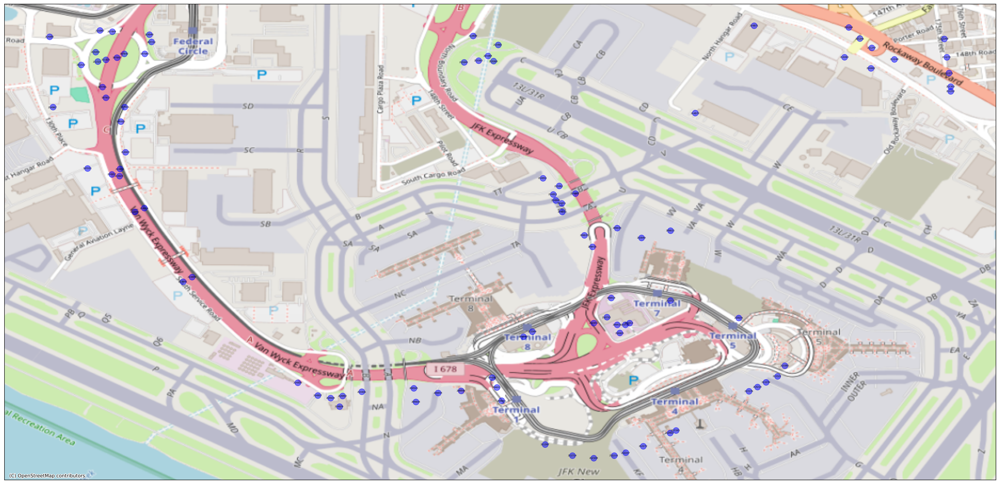

In [101]:
west, south, east, north = (-73.81, 40.640, -73.77, 40.66)
fig = plot_map(graph, -73.81, 40.640, -73.77, 40.66, filepath=os.path.join(base_path, 'jfk.png'))

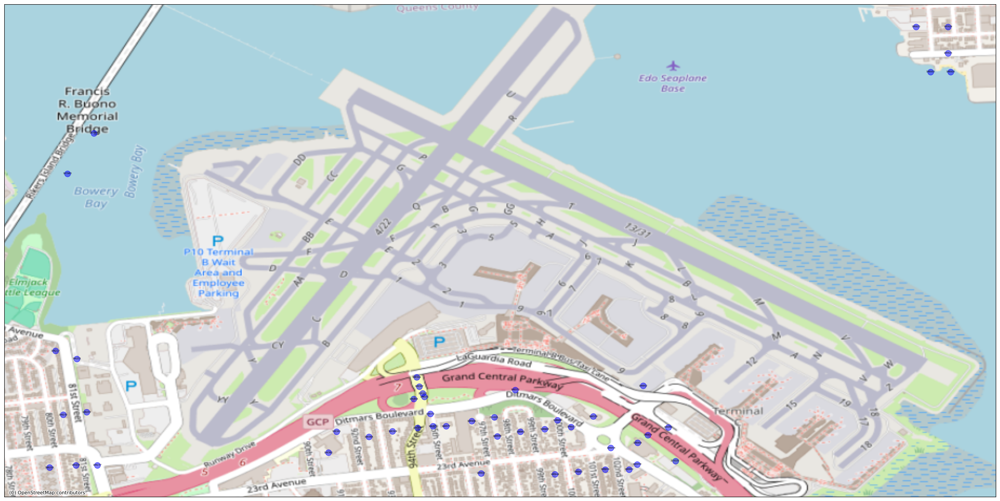

In [102]:
west, south, east, north = (-73.89, 40.768, -73.856, 40.785)
fig = plot_map(graph, -73.89, 40.768, -73.856, 40.785, filepath=os.path.join(base_path, 'laguardia.png'))

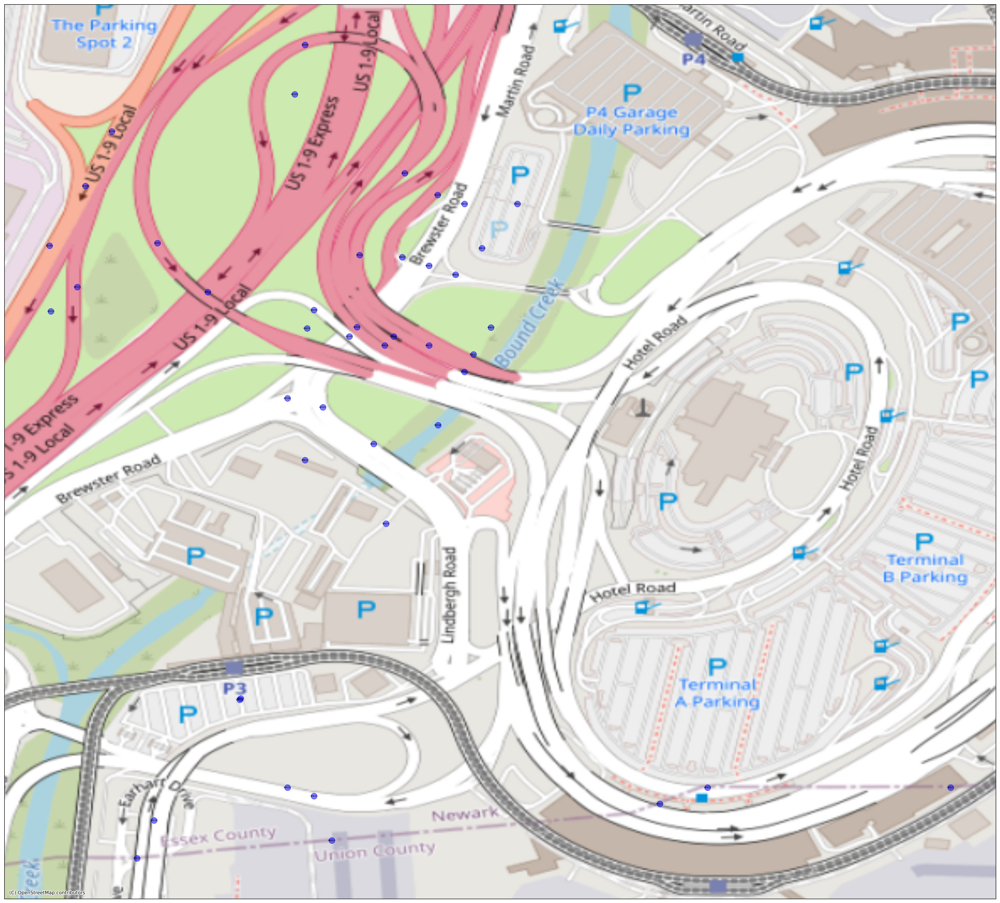

In [103]:
west, south, east, north = (-74.19, 40.686, -74.17, 40.697)
fig = plot_map(graph, -74.19, 40.686, -74.17, 40.697, filepath=os.path.join(base_path, 'newark.png'))

In [104]:
jfk_node = 212410
laguardia_node = 198373
newark_node = 49611

In [105]:
import heapq 
# use heapq.heappop(listname) to retrieve an element
# use heapq.heappush(listname, (key, value)) to store an element in the heap
# don't perform other list manipulations as those could destroy the heap property  

def dijkstra(graph: nx.Graph, src: int, dst: int):
    # Priority queue to hold (distance, node)
    pq = []
    heapq.heappush(pq, (0, src))

    dist = {node: float('inf') for node in graph.nodes()}
    pred = {node: None for node in graph.nodes()}
    dist[src] = 0

    while pq:
        current_dist, v_star = heapq.heappop(pq)

        # Early exit if we reach the destination
        if v_star == dst:
            break

        if current_dist > dist[v_star]:
            continue

        for neighbor in graph.neighbors(v_star):
            weight = graph[v_star][neighbor].get('weight', 1)
            new_dist = current_dist + weight

            if new_dist < dist[neighbor]:
                dist[neighbor] = new_dist
                pred[neighbor] = v_star
                heapq.heappush(pq, (new_dist, neighbor))

    return dist[dst], pred


def construct_path(pred, start, end):
    path = []
    step = end

    while step is not None:
        path.insert(0, step)
        step = pred[step]

    # If the start node is not in the path, then there is no path
    if path[0] != start:
        return []

    return path


JFK to LaGuardia: 197292 [212410, 212272, 212247, 212216, 212108, 211714, 211397, 209650, 209651, 209546, 209545, 214406, 214889, 214404, 214403, 198000, 197581, 197580, 207732, 214948, 214947, 214863, 208645, 208644, 208647, 194686, 208559, 208562, 208561, 208560, 208552, 208551, 208525, 208519, 208505, 208502, 207742, 207612, 207601, 207566, 207547, 207545, 207532, 207530, 207378, 194524, 207376, 207371, 207369, 207353, 207354, 207334, 207307, 207301, 203962, 203961, 207295, 207292, 207291, 207279, 207274, 207273, 205801, 205797, 205791, 205787, 205777, 205774, 205759, 205758, 205707, 205706, 205694, 204804, 204803, 205693, 205692, 214391, 214386, 199876, 199875, 199663, 205685, 203420, 203419, 203405, 203404, 203389, 203388, 214326, 213480, 203352, 201726, 214328, 203088, 203087, 203356, 202552, 194522, 194521, 214330, 202991, 202990, 214896, 202987, 202986, 202969, 202968, 199554, 199553, 202872, 202868, 198789, 198788, 202867, 198792, 198791, 200000, 214870, 214869, 215091, 199427

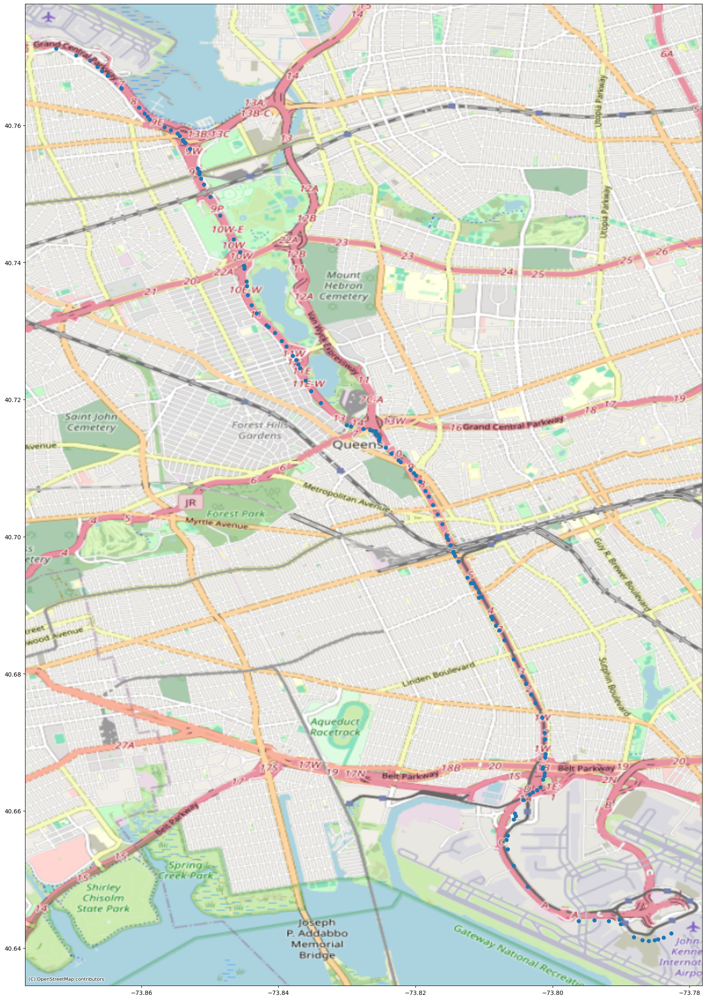

In [106]:
(distance, pred) = dijkstra(graph, jfk_node, laguardia_node)
path1 = construct_path(pred, jfk_node, laguardia_node)
print("JFK to LaGuardia:", distance, path1)
fig = plot_path(graph, path1)

LaGuardia to NewArk: 436028 [198373, 198371, 198368, 198361, 198300, 198259, 202124, 214300, 214836, 214295, 214296, 214291, 214292, 214779, 198241, 214298, 198164, 198165, 198181, 198187, 198188, 198194, 198531, 198530, 198541, 198542, 198546, 195647, 195645, 195646, 195676, 195679, 195693, 195694, 195704, 195703, 195710, 195697, 195671, 195699, 195787, 195786, 195780, 214674, 195778, 195776, 195299, 195749, 197305, 197304, 195733, 195732, 195735, 195730, 195729, 195728, 198502, 198498, 199935, 195290, 194679, 214774, 195256, 195255, 214756, 214773, 214772, 214813, 195105, 214903, 214455, 195085, 195083, 214811, 195072, 194681, 214812, 195018, 194895, 194889, 194868, 194866, 194865, 194862, 194856, 194861, 194853, 194849, 194842, 194841, 194825, 194640, 194639, 194696, 194695, 194685, 194675, 194674, 194667, 214978, 194665, 194663, 194664, 214432, 194656, 194655, 214430, 194638, 194632, 194539, 194534, 194538, 190670, 187192, 187191, 190534, 190666, 187034, 187032, 187031, 187033, 187

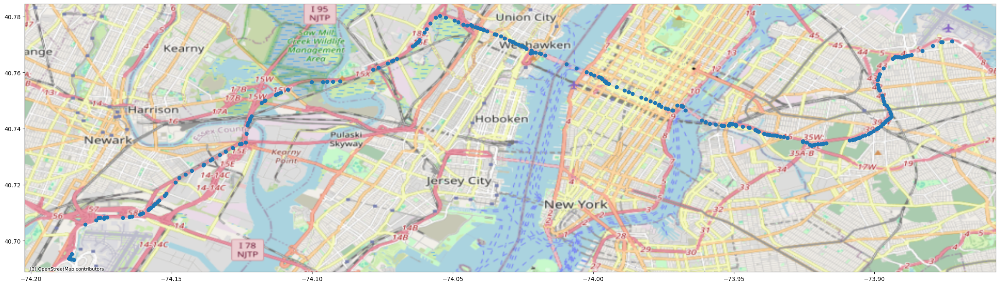

In [107]:
(distance, pred) = dijkstra(graph, laguardia_node, newark_node)
path2 = construct_path(pred, laguardia_node, newark_node)
print("LaGuardia to NewArk:", distance, path2)
fig = plot_path(graph, path2)

NewArk to JFK: 595673 [49611, 49610, 49609, 49599, 49598, 49592, 49034, 49035, 49036, 49044, 49178, 49179, 49040, 49181, 49183, 49194, 49197, 49462, 49464, 49463, 49456, 49454, 49452, 48980, 49458, 49475, 49474, 49476, 49477, 49441, 49525, 49523, 49521, 49548, 49556, 49559, 49773, 49738, 49736, 49745, 49746, 49748, 49750, 49759, 49758, 49756, 49757, 53671, 53670, 53669, 53667, 53665, 53672, 53673, 52767, 52768, 52769, 52772, 50651, 50652, 50657, 50658, 50659, 50660, 50835, 50837, 50838, 50884, 50885, 50878, 50879, 55683, 56621, 56622, 56623, 50862, 51178, 51179, 51180, 51182, 51183, 51189, 51191, 51193, 51248, 51249, 51253, 51254, 51255, 51256, 51257, 51259, 51278, 51282, 51287, 51288, 51290, 51308, 51348, 52235, 52245, 52263, 52268, 52278, 52340, 52341, 52349, 52353, 52367, 52381, 52494, 52375, 52496, 56588, 56589, 52597, 56590, 52590, 52591, 56591, 189753, 189662, 189663, 187371, 190617, 190621, 190620, 190616, 190814, 190816, 190812, 190811, 187391, 187390, 187520, 187528, 189415, 1

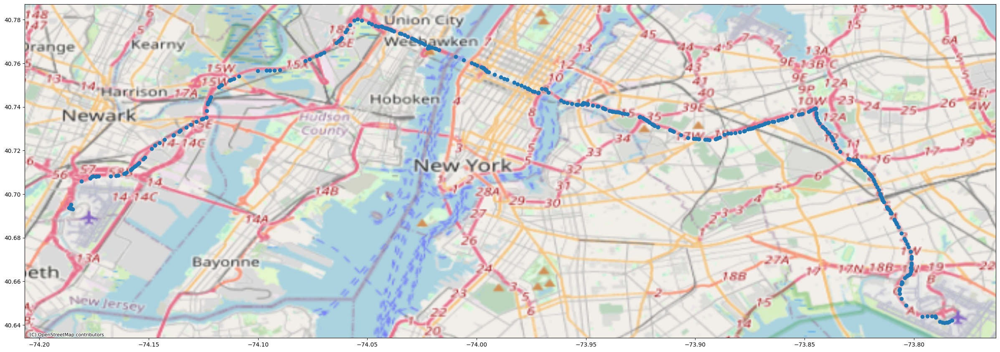

In [108]:
(distance, pred) = dijkstra(graph, newark_node, jfk_node)
path3 = construct_path(pred, newark_node, jfk_node)
print("NewArk to JFK:", distance, path3)
fig = plot_path(graph, path3)

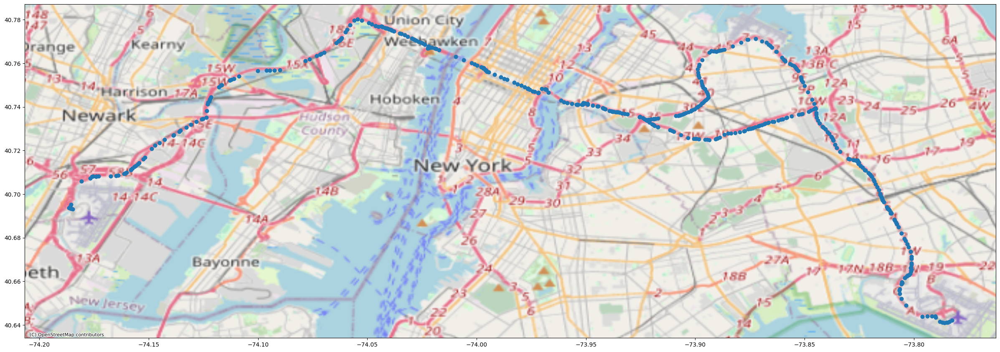

In [109]:
roundtrip = path1+path2+path3
fig = plot_path(graph, roundtrip)